In [1]:
!pip install koreanize_matplotlib

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.9/7.9 MB 77.2 MB/s eta 0:00:00:00:0100:01


In [2]:
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.layers import Input, Dense , Conv2D , Dropout , Flatten , Activation, MaxPooling2D , GlobalAveragePooling2D
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import Sequence
import tensorflow as tf
from tensorflow.keras.utils import to_categorical
import sklearn
from sklearn.model_selection import train_test_split
import cv2
import albumentations as A
import os
import seaborn as sns
import sklearn
from sklearn.model_selection import train_test_split
import cv2
import os
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import koreanize_matplotlib
import seaborn as sns
import numpy as np
from PIL import Image
import shutil
import warnings
import unicodedata
from pathlib import Path

/opt/conda/lib/python3.10/site-packages/albumentations/__init__.py:13: UserWarning: A new version of Albumentations is available: 1.4.21 (you have 1.4.17). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [3]:
pd.set_option('display.max_colwidth', 200)

def get_label(file_paths, test_size=0.02):
    paths = []
    dataset_gubuns = []
    label_gubuns = []

    for file_path in Path(file_paths).rglob("*.jpg"):
        file_path = unicodedata.normalize('NFC', str(file_path))
        paths.append(file_path)
        label = '/'.join(file_path.split('/')[-2:-1])  
        label_gubuns.append(label)
        dataset_gubuns.append('train')

    data_df = pd.DataFrame({'path': paths, 'label': label_gubuns, 'dataset': dataset_gubuns})
    for label in data_df['label'].unique():
        label_df = data_df[data_df['label'] == label]
        train_df, val_df = train_test_split(label_df, test_size=test_size, random_state=42)
        data_df.loc[val_df.index, 'dataset'] = 'val'
    return data_df


In [4]:
pd.set_option('display.max_colwidth', 200)

def get_food_filepaths(file_paths, test_size=0.02):
    paths = []
    dataset_gubuns = []
    label_gubuns = []

    for dirname, _, filenames in os.walk(file_paths):    
        for filename in filenames:
            if '.jpg' in filename:
                file_path = os.path.join(dirname, filename)
                paths.append(file_path)
                label = '/'.join(file_path.split('/')[-2:-1])
                label_gubuns.append(label)
                dataset_gubuns.append('train')


    data_df = pd.DataFrame({'path': paths, 'label': label_gubuns, 'dataset': dataset_gubuns})
    for label in data_df['label'].unique():
        label_df = data_df[data_df['label'] == label]
        train_df, val_df = train_test_split(label_df, test_size=test_size, random_state=42)
        data_df.loc[val_df.index, 'dataset'] = 'val'

    return data_df


In [5]:
file_paths = '/kaggle/input/k-food'

k_food = get_food_filepaths(file_paths)
k_label = get_label(file_paths)
k_food.shape

(142642, 3)

In [6]:
k_food.head(2)

,path,label,dataset
0,/kaggle/input/k-food/cleaned_kfood/황태구이/Img_012_0036.jpg,cleaned_kfood/황태구이,train
1,/kaggle/input/k-food/cleaned_kfood/황태구이/Img_012_0808.jpg,cleaned_kfood/황태구이,train


In [7]:
k_label.head(2)

,path,label,dataset
0,/kaggle/input/k-food/cleaned_kfood/황태구이/Img_012_0036.jpg,황태구이,train
1,/kaggle/input/k-food/cleaned_kfood/황태구이/Img_012_0808.jpg,황태구이,train


In [8]:
k_food[k_food['label']=='갓김치']

,path,label,dataset


In [9]:
k_food['label'] = k_label['label']

In [10]:
k_food

,path,label,dataset
0,/kaggle/input/k-food/cleaned_kfood/황태구이/Img_012_0036.jpg,황태구이,train
1,/kaggle/input/k-food/cleaned_kfood/황태구이/Img_012_0808.jpg,황태구이,train
2,/kaggle/input/k-food/cleaned_kfood/황태구이/Img_012_0503.jpg,황태구이,train
3,/kaggle/input/k-food/cleaned_kfood/황태구이/Img_012_0101.jpg,황태구이,train
4,/kaggle/input/k-food/cleaned_kfood/황태구이/Img_012_0312.jpg,황태구이,train
...,...,...,...
142637,/kaggle/input/k-food/cleaned_kfood/된장찌개/Img_122_0552.jpg,된장찌개,val
142638,/kaggle/input/k-food/cleaned_kfood/된장찌개/Img_122_0407.jpg,된장찌개,train
142639,/kaggle/input/k-food/cleaned_kfood/된장찌개/Img_122_0175.jpg,된장찌개,train
142640,/kaggle/input/k-food/cleaned_kfood/된장찌개/Img_122_0151.jpg,된장찌개,train


In [11]:
rust_image_list = k_food[k_food['label']=='육회']['path'].iloc[:6].tolist()
rust_image_list

['/kaggle/input/k-food/cleaned_kfood/육회/Img_149_0006.jpg',
 '/kaggle/input/k-food/cleaned_kfood/육회/Img_149_0172.jpg',
 '/kaggle/input/k-food/cleaned_kfood/육회/Img_149_0186.jpg',
 '/kaggle/input/k-food/cleaned_kfood/육회/Img_149_0343.jpg',
 '/kaggle/input/k-food/cleaned_kfood/육회/Img_149_0290.jpg',
 '/kaggle/input/k-food/cleaned_kfood/육회/Img_149_0244.jpg']

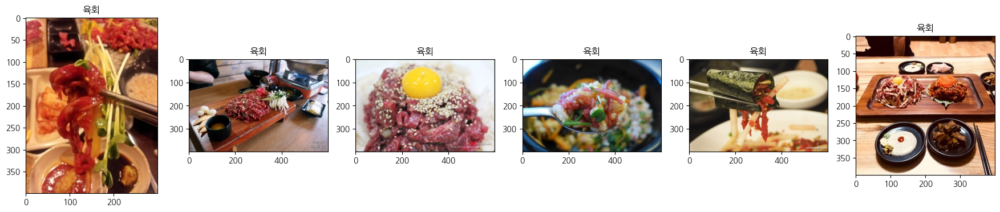

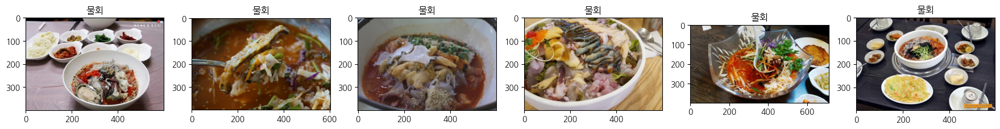

In [74]:
def show_grid_images(image_path_list, augmentor=None, ncols=4, title=None):
    figure, axs = plt.subplots(figsize=(22, 4), nrows=1, ncols=ncols)
    for i in range(ncols):
        image = cv2.cvtColor(cv2.imread(image_path_list[i]), cv2.COLOR_BGR2RGB)
        if augmentor is not None:
            image = augmentor(image=image)['image']
        axs[i].imshow(image)
        axs[i].set_title(title)
        
rust_image_list = k_food[k_food['label']=='육회']['path'].iloc[:6].tolist()
scab_image_list = k_food[k_food['label']=='물회']['path'].iloc[:6].tolist()

show_grid_images(rust_image_list, ncols=6, title='육회')
show_grid_images(scab_image_list, ncols=6, title='물회')


In [144]:
data = {
    'train_accuracy': [ 0.9878, 0.6462, 0.8988, 0.8651],
    'train_loss': [ 0.0369, 1.2476, 0.3264, 0.4469]}

index = ['EfficientNetB3(fine tuning1)', 'VGG19', 'EfficientNetB3(fine tuning2)', 'InceptionResNetV2']

labels = pd.DataFrame(data, index=index).reset_index()
labels = labels.rename(columns={'train_accuracy': 'Train Accuracy', 'train_loss': 'Train Loss'})
labels

,index,Train Accuracy,Train Loss
0,EfficientNetB3(fine tuning1),0.9878,0.0369
1,VGG19,0.6462,1.2476
2,EfficientNetB3(fine tuning2),0.8988,0.3264
3,InceptionResNetV2,0.8651,0.4469


In [152]:
data_val = {
    'val_accuracy': [ 0.8771, 0.4166, 0.8424, 0.7781],
    'val_loss': [ 0.7107, 2.5885, 0.5925, 0.8275]}

index = ['EfficientNetB3(fine tuning1)', 'VGG19', 'EfficientNetB3(fine tuning2)', 'InceptionResNetV2']

labels1 = pd.DataFrame(data_val, index=index).reset_index()
labels1 = labels1.rename(columns={'val_accuracy': 'Val Accuracy', 'val_loss': 'Val Loss'})
labels1

,index,Val Accuracy,Val Loss
0,EfficientNetB3(fine tuning1),0.8771,0.7107
1,VGG19,0.4166,2.5885
2,EfficientNetB3(fine tuning2),0.8424,0.5925
3,InceptionResNetV2,0.7781,0.8275


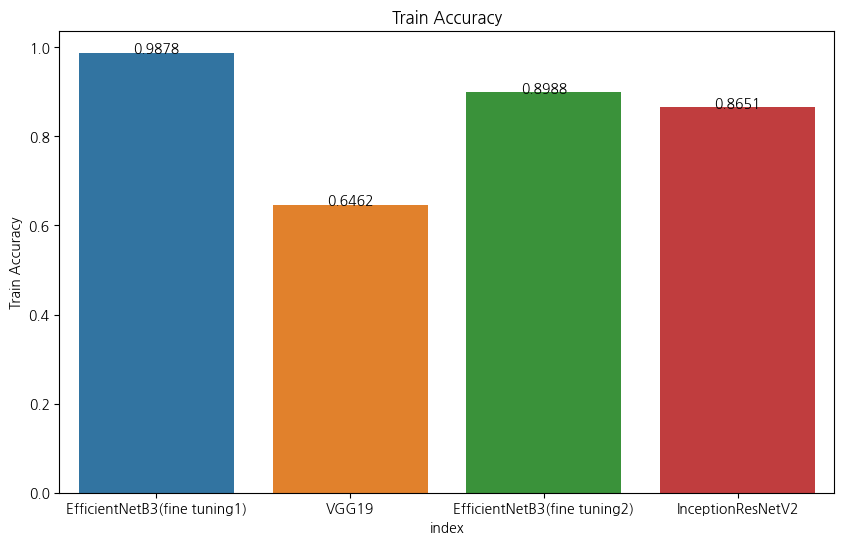

In [158]:
plt.figure(figsize=(10, 6))
ax = sns.barplot(x='index', y='Train Accuracy', data=labels)
plt.title('Train Accuracy')

for p in ax.patches:
    ax.annotate(f'{p.get_height():.4f}', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='baseline')
plt.show()

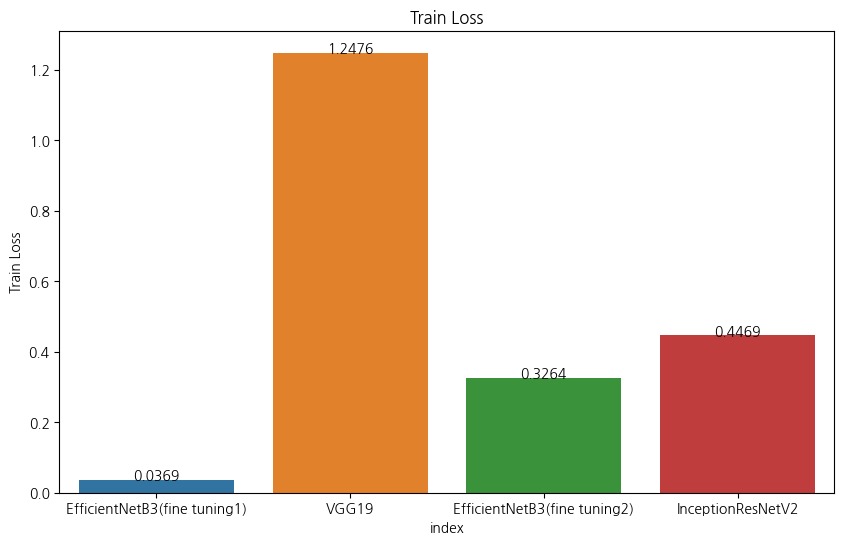

In [159]:
plt.figure(figsize=(10, 6))
ax = sns.barplot(x='index', y='Train Loss', data=labels)
plt.title('Train Loss')

for p in ax.patches:
    ax.annotate(f'{p.get_height():.4f}', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='baseline')
plt.show()

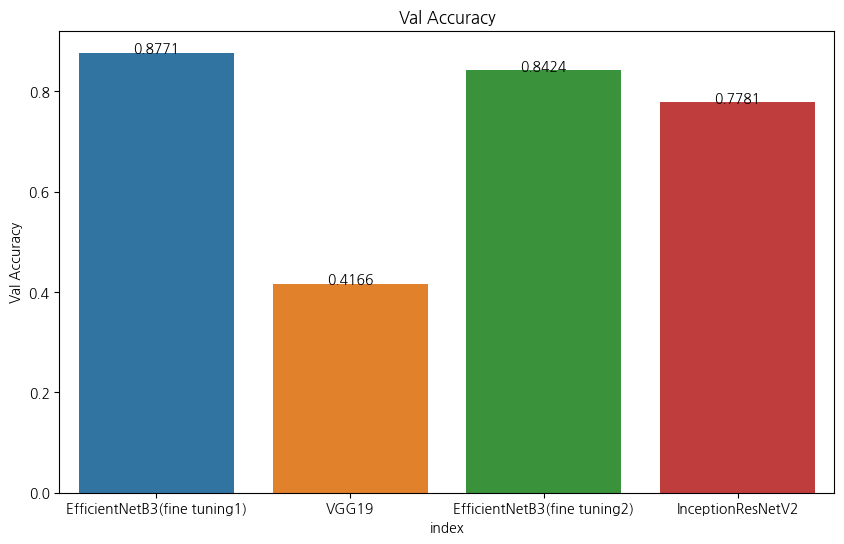

In [160]:
plt.figure(figsize=(10, 6))
ax = sns.barplot(x='index', y='Val Accuracy', data=labels1)
plt.title('Val Accuracy')

for p in ax.patches:
    ax.annotate(f'{p.get_height():.4f}', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='baseline')
plt.show()

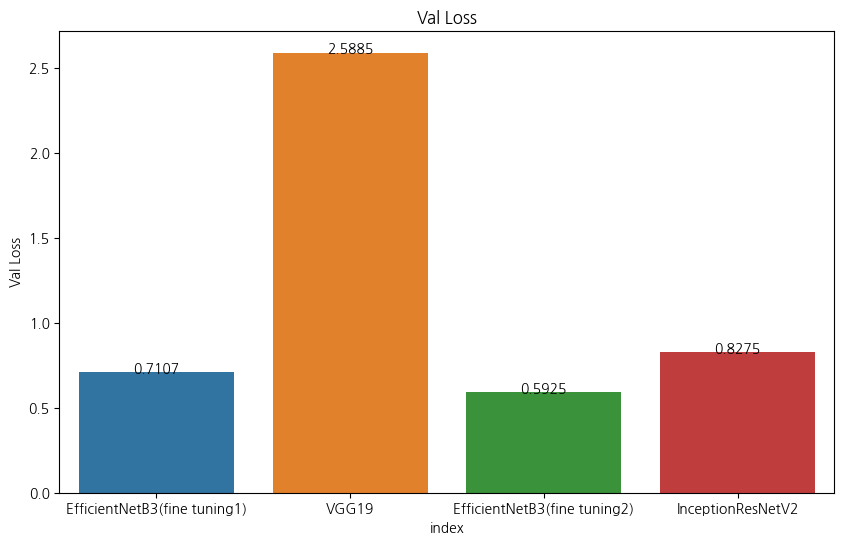

In [161]:
plt.figure(figsize=(10, 6))
ax = sns.barplot(x='index', y='Val Loss', data=labels1)
plt.title('Val Loss')

for p in ax.patches:
    ax.annotate(f'{p.get_height():.4f}', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='baseline')
plt.show()

In [12]:
BATCH_SIZE = 32
# IMAGE_SIZE = 256
IMAGE_SIZE = 300

class Food_Dataset(Sequence):
    def __init__(self, image_filenames, labels, batch_size=BATCH_SIZE, augmentor=None, shuffle=False, pre_func=None):

        self.image_filenames = image_filenames
        self.labels = labels
        self.batch_size = batch_size
        self.augmentor = augmentor
        self.pre_func = pre_func
        self.shuffle = shuffle
        if self.shuffle:
            pass
    
    def __len__(self):
        return int(np.ceil(len(self.image_filenames)/BATCH_SIZE))

    def __getitem__(self, index):
        image_name_batch = self.image_filenames[index * self.batch_size:(index + 1) * self.batch_size]
        if self.labels is not None:
            label_batch = self.labels[index * self.batch_size:(index + 1) * self.batch_size]
        
        image_batch = np.zeros((image_name_batch.shape[0], IMAGE_SIZE, IMAGE_SIZE, 3), dtype='float32')
 
        for image_index in range(image_name_batch.shape[0]):

            image = cv2.imread(image_name_batch[image_index])
            if image is None:
                # print(f"이미지 오류: {image_name_batch[image_index]}")
                continue
            
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            image = cv2.resize(image, (IMAGE_SIZE, IMAGE_SIZE))
            if self.augmentor is not None:
                image = self.augmentor(image=image)['image']
            
            if self.pre_func is not None:
                image = self.pre_func(image)
                
            image_batch[image_index] = image
        
        if self.labels is None:
            return image_batch
        else:        
            return image_batch, label_batch
    
    def on_epoch_end(self):
        if(self.shuffle):
            self.image_filenames, self.labels = sklearn.utils.shuffle(self.image_filenames, self.labels)
        else:
            pass

In [13]:
def get_train_valid(data_df):
    k_food = data_df
    train_df = k_food[k_food['dataset']=='train']
    val_df = k_food[k_food['dataset']=='val']

    tr_path = train_df['path'].values
    tr_label = pd.factorize(train_df['label'])[0]
    tr_label = to_categorical(tr_label)
    
    val_path = val_df['path'].values
    val_label = pd.factorize(val_df['label'])[0]
    val_label = to_categorical(val_label) 

    print('학습용 shape:', tr_path.shape, '검증용 shape:', val_path.shape, '학습용 label:', tr_label.shape, '검증용 label:', val_label.shape)
    return tr_path, tr_label, val_path, val_label


In [14]:
def create_model(model_type='xception', in_shape=(IMAGE_SIZE, IMAGE_SIZE, 3), n_classes=145, freeze_layers=50, verbose=False):
    input_tensor = Input(shape=in_shape)
    if model_type == 'resnet50v2':
        base_model = tf.keras.applications.ResNet50V2(include_top=False, weights='imagenet', input_tensor=input_tensor)
    elif model_type == 'xception':
        base_model = tf.keras.applications.Xception(include_top=False, weights='imagenet', input_tensor=input_tensor)
    elif model_type == 'efficientnetb0':
        base_model = tf.keras.applications.EfficientNetB0(include_top=False, weights='imagenet', input_tensor=input_tensor)
    elif model_type == 'efficientnetb1':
        base_model = tf.keras.applications.EfficientNetB1(include_top=False, weights='imagenet', input_tensor=input_tensor)
    elif model_type == 'efficientnetb3':
        base_model = tf.keras.applications.EfficientNetB3(include_top=False, weights='imagenet', input_tensor=input_tensor)

    # freeze
    for layer in base_model.layers[:-freeze_layers]:
        layer.trainable = False
        
    # Unfreeze remaining layers but keep BatchNormalization layers frozen -> 케라스 공식문서 팁
    # https://keras.io/examples/vision/image_classification_efficientnet_fine_tuning/
    for layer in base_model.layers[-freeze_layers:]:
        if not isinstance(layer, tf.keras.layers.BatchNormalization):
            layer.trainable = True
        else:
            layer.trainable = False

    feature_extractor = Model(inputs=input_tensor, outputs=base_model.output)

    x = base_model.output  
    x = GlobalAveragePooling2D()(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.5)(x)    
    
    preds = Dense(units=n_classes, activation='softmax')(x)
    model = Model(inputs=input_tensor, outputs=preds)
    
    if verbose:
        model.summary()
        
    return model, feature_extractor

In [15]:
def lrfn(epoch): 
    LR_START = 1e-5
    LR_MAX = 1e-4
    LR_RAMPUP_EPOCHS = 2
    LR_SUSTAIN_EPOCHS = 1
    LR_STEP_DECAY = 0.75
    
    def calc_fn(epoch):
        if epoch < LR_RAMPUP_EPOCHS:
            lr = (LR_MAX - LR_START) / LR_RAMPUP_EPOCHS * epoch + LR_START
        elif epoch < LR_RAMPUP_EPOCHS + LR_SUSTAIN_EPOCHS:
            lr = LR_MAX
        else:
            lr = LR_MAX * LR_STEP_DECAY**((epoch - LR_RAMPUP_EPOCHS - LR_SUSTAIN_EPOCHS)//2)
        return lr

    return calc_fn(epoch)


In [16]:
def train_model(model_type, train_df, initial_lr=0.001, augmentor=None, input_pre_func=None):
    tr_path, tr_label, val_path, val_label = get_train_valid(train_df)
    print('학습용 shape:', tr_path.shape, '검증용 shape:', val_path.shape, '학습용 label:', tr_label.shape, '검증용 label:', val_label.shape)
    
    tr_ds = Food_Dataset(tr_path, tr_label, batch_size=BATCH_SIZE, augmentor=augmentor, shuffle=True, pre_func=input_pre_func)
    val_ds = Food_Dataset(val_path, val_label, batch_size=BATCH_SIZE, augmentor=None, shuffle=False, pre_func=input_pre_func)


    # strategy = tf.distribute.MirroredStrategy(devices=["/gpu:0", "/gpu:1"])
    # with strategy.scope():
    print('#######', model_type, ' 생성 및 학습 수행 ########')
    model, feature_extractor = create_model(model_type=model_type)
    model.compile(optimizer=Adam(learning_rate=initial_lr), loss='categorical_crossentropy', metrics=['accuracy'])
    
    lr_cb = tf.keras.callbacks.LearningRateScheduler(lrfn, verbose=1)
    model_path = '/kaggle/working/{epoch:02d}-{val_loss:.4f}.keras'
    checkpoint = ModelCheckpoint(filepath=model_path, monitor='val_loss', verbose=0, save_best_only=True)
        
    history = model.fit(tr_ds, epochs=N_EPOCHS, validation_data=val_ds, callbacks=([lr_cb, checkpoint]), verbose=1)
    return model, feature_extractor, history

In [22]:
pd.set_option('display.max_colwidth', 200)

def get_label(file_paths, test_size=0.05):
    paths = []
    dataset_gubuns = []
    label_gubuns = []

    for file_path in Path(file_paths).rglob("*.png"):
        file_path = unicodedata.normalize('NFC', str(file_path))
        paths.append(file_path)
        label = '/'.join(file_path.split('/')[-2:-1]) 
        label_gubuns.append(label)
        dataset_gubuns.append('train')

    data_df = pd.DataFrame({'path': paths, 'label': label_gubuns, 'dataset': dataset_gubuns})
    return data_df


In [23]:
pd.set_option('display.max_colwidth', 200)

def get_food_pred(file_paths):
    paths = []
    dataset_gubuns = []
    label_gubuns = []

    for dirname, _, filenames in os.walk(file_paths):    
        for filename in filenames:
            if '.png' in filename:
                file_path = os.path.join(dirname, filename)
                paths.append(file_path)
                label = '/'.join(file_path.split('/')[-2:-1])
                label_gubuns.append(label)
                dataset_gubuns.append('train')
                
    data_df = pd.DataFrame({'path': paths, 'label': label_gubuns, 'dataset': dataset_gubuns})
    return data_df


In [26]:
file_paths = '/kaggle/input/food-plus'

k_food_pred = get_food_pred(file_paths)
k_label_pred = get_label(file_paths)
k_food_pred.shape

(60, 3)

In [30]:
k_food_pred['label'] = k_label_pred['label']
k_food_pred

,path,label,dataset
0,/kaggle/input/food-plus/food_pred/제육볶음/스크린샷 2024-11-11 오후 10.26.51.png,제육볶음,train
1,/kaggle/input/food-plus/food_pred/제육볶음/스크린샷 2024-11-11 오후 10.27.05.png,제육볶음,train
2,/kaggle/input/food-plus/food_pred/제육볶음/스크린샷 2024-11-11 오후 10.26.44.png,제육볶음,train
3,/kaggle/input/food-plus/food_pred/유부초밥/스크린샷 2024-11-14 오전 10.28.46.png,유부초밥,train
4,/kaggle/input/food-plus/food_pred/유부초밥/스크린샷 2024-11-14 오전 10.28.29.png,유부초밥,train
5,/kaggle/input/food-plus/food_pred/유부초밥/스크린샷 2024-11-14 오전 10.28.36.png,유부초밥,train
6,/kaggle/input/food-plus/food_pred/조기구이/스크린샷 2024-11-11 오후 10.19.23.png,조기구이,train
7,/kaggle/input/food-plus/food_pred/조기구이/스크린샷 2024-11-11 오후 10.19.33.png,조기구이,train
8,/kaggle/input/food-plus/food_pred/조기구이/스크린샷 2024-11-11 오후 10.19.17.png,조기구이,train
9,/kaggle/input/food-plus/food_pred/콩나물국/스크린샷 2024-11-11 오후 10.25.07.png,콩나물국,train


In [31]:
from tensorflow.keras.applications.efficientnet import preprocess_input as eff_preprocess_input

preprocessing_func = eff_preprocess_input


pred_df = k_food_pred
pred_path = pred_df['path'].values
# pred_label = pd.factorize(pred_df['label'])[0]
# pred_label = to_categorical(pred_label) 

pred_ds = Food_Dataset(pred_path, None, batch_size=BATCH_SIZE, augmentor=None, shuffle=False, pre_func=preprocessing_func)

In [32]:
train_df = k_food
tr_label, unique_labels = pd.factorize(train_df['label'])
tr_label = to_categorical(tr_label) 

In [33]:
# model2 = load_model('/kaggle/input/best-models/food/google/googlenet.keras')
model2 = load_model('/kaggle/input/best-models/food/effi_batch_fix/effi_batch_fix.h5') # 최고 성능 

In [34]:
predictions = model2.predict(pred_ds)
predicted_labels = np.argmax(predictions, axis=1)
predicted_labels_list = [unique_labels[label] for label in predicted_labels]

/opt/conda/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1731549656.275861     112 service.cc:145] XLA service 0x7901d00044f0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1731549656.275918     112 service.cc:153]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0


1/2 ━━━━━━━━━━━━━━━━━━━━ 11s 12s/step

I0000 00:00:1731549664.707487     112 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


2/2 ━━━━━━━━━━━━━━━━━━━━ 23s 11s/step


In [35]:
# predictions = model2.predict(pred_ds)
# predicted_labels = np.argmax(predictions, axis=1)

predicted_labels_list = [unique_labels[label] for label in predicted_labels]

k_food_pred['pred'] = predicted_labels_list

In [36]:
accuracy = (k_food_pred['label'] == k_food_pred['pred']).mean()
print(f'정확도: {accuracy * 100:.2f}%') # 72.73

정확도: 100.00%


In [37]:
# k_food_pred.drop(['dataset'], axis=1, inplace=True)
k_food_pred

,path,label,dataset,pred
0,/kaggle/input/food-plus/food_pred/제육볶음/스크린샷 2024-11-11 오후 10.26.51.png,제육볶음,train,제육볶음
1,/kaggle/input/food-plus/food_pred/제육볶음/스크린샷 2024-11-11 오후 10.27.05.png,제육볶음,train,제육볶음
2,/kaggle/input/food-plus/food_pred/제육볶음/스크린샷 2024-11-11 오후 10.26.44.png,제육볶음,train,제육볶음
3,/kaggle/input/food-plus/food_pred/유부초밥/스크린샷 2024-11-14 오전 10.28.46.png,유부초밥,train,유부초밥
4,/kaggle/input/food-plus/food_pred/유부초밥/스크린샷 2024-11-14 오전 10.28.29.png,유부초밥,train,유부초밥
5,/kaggle/input/food-plus/food_pred/유부초밥/스크린샷 2024-11-14 오전 10.28.36.png,유부초밥,train,유부초밥
6,/kaggle/input/food-plus/food_pred/조기구이/스크린샷 2024-11-11 오후 10.19.23.png,조기구이,train,조기구이
7,/kaggle/input/food-plus/food_pred/조기구이/스크린샷 2024-11-11 오후 10.19.33.png,조기구이,train,조기구이
8,/kaggle/input/food-plus/food_pred/조기구이/스크린샷 2024-11-11 오후 10.19.17.png,조기구이,train,조기구이
9,/kaggle/input/food-plus/food_pred/콩나물국/스크린샷 2024-11-11 오후 10.25.07.png,콩나물국,train,콩나물국


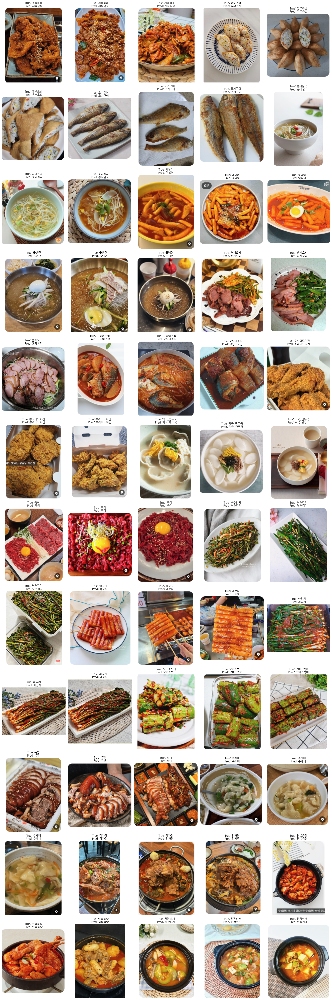

In [40]:
def visualize_predictions(df, num_images):
    sample_df = df.iloc[:min(num_images, len(df))]
    rows = (num_images + 4) // 5
    fig, axes = plt.subplots(rows, 5, figsize=(20, 5 * rows))

    if rows > 1:
        axes = axes.ravel()

    for i, (index, row) in enumerate(sample_df.iterrows()):
        img_path = row['path']
        true_label = row['label']
        predicted_label = row['pred']

        image = cv2.imread(img_path)
        if image is not None:
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            axes[i].imshow(image)
            axes[i].axis('off')
            axes[i].set_title(f"True: {true_label}\nPred: {predicted_label}")
 
    # 만약 이미지 개수가 행*열보다 적다면 남은 축을 숨깁니다.
    for j in range(i + 1, rows * 5):
        axes[j].axis('off')
 
    plt.tight_layout()
    plt.show()
    
# 예시 호출
visualize_predictions(k_food_pred, num_images=60)